In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from collections import defaultdict
import plotly.express as px
import plotly.graph_objs as go

## Generating dummy curves and spaghetti plot

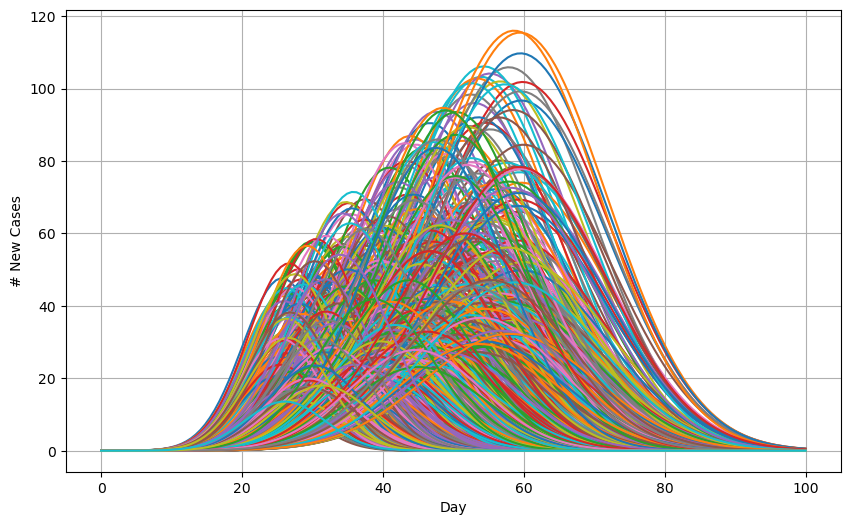

In [2]:
# Parameters
num_curves = 1000 # Number of bell curves
x_range = (0, 100)       # Range of x values
x_points = 150          # Number of points in each curve

# Generate x values
x = np.linspace(x_range[0], x_range[1], x_points)

curve_data = dict()

# Create a figure and axis for plotting
plt.figure(figsize=(10, 6))

np.random.seed(1)
# Generate and plot each bell curve
for i in range(num_curves):
    mean = np.random.uniform(25, 60)  # Random mean for each bell curve
    std_dev = np.abs(mean) / 5 + 0.5  # Standard deviation inversely proportional to mean
    amplitude = np.abs(mean) / np.random.uniform(0.5, 2.0)  # Random amplitude for each curve
    y = amplitude * np.exp(-0.5 * ((x - mean) / std_dev) ** 2)
    curve_data[i] = y  # storing data for later
    plt.plot(x, y, label=f'Curve {i+1} (mean={mean:.2f}, std_dev={std_dev:.2f}, amplitude={amplitude:.2f})');
    
# Add labels and title
plt.xlabel('Day')
plt.ylabel('# New Cases')

# Show the plot
plt.grid(True)
plt.show()

## Testing [curvestat](https://github.com/jonassjuul/curvestat)

In [3]:
df_curve = pd.DataFrame(curve_data)
df_curve.head()

,0,1,2,3,4,5,6,7,8,9,...,990,991,992,993,994,995,996,997,998,999
0,0.000394,0.000855,0.001109,0.000677,0.000479,0.000408,0.000375,0.000525,0.000466,0.000893,...,0.000550,0.000331,0.000678,0.000691,0.001059,0.000507,0.000377,0.000507,0.000396,0.000410
1,0.000572,0.001478,0.001774,0.001064,0.000699,0.000591,0.000585,0.000892,0.000675,0.001432,...,0.000877,0.000431,0.000991,0.000926,0.001620,0.000668,0.000526,0.000676,0.000623,0.000695
2,0.000824,0.002517,0.002807,0.001656,0.001013,0.000851,0.000904,0.001496,0.000973,0.002272,...,0.001386,0.000559,0.001437,0.001237,0.002457,0.000877,0.000732,0.000898,0.000970,0.001163
3,0.001180,0.004222,0.004395,0.002552,0.001459,0.001218,0.001384,0.002473,0.001393,0.003566,...,0.002166,0.000724,0.002072,0.001647,0.003696,0.001149,0.001012,0.001188,0.001497,0.001920
4,0.001679,0.006978,0.006808,0.003896,0.002086,0.001732,0.002099,0.004033,0.001982,0.005539,...,0.003349,0.000934,0.002968,0.002184,0.005511,0.001499,0.001392,0.001566,0.002287,0.003126


In [4]:
from curvestat import CurveBoxPlot
from curvestat import LoadRisk
from time import time

In [5]:
# Array of time steps
time_arr = np.arange(0,len(df_curve[0]),1)
time_arr;

Ran 1000 curves in 6.02 seconds


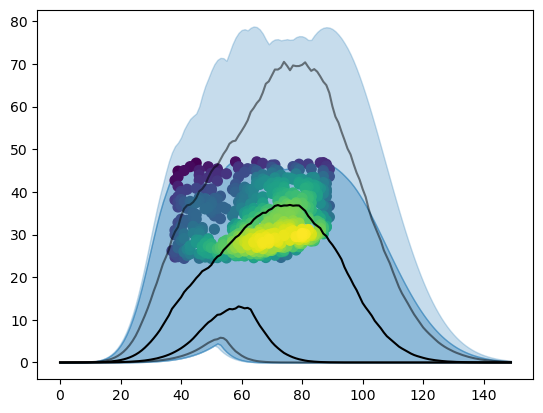

In [6]:
start = time()
Boxplot = CurveBoxPlot(curves=df_curve,sample_curves=5,sample_repititions=20,time=time_arr)

# Choose ranking
rank_allornothing=Boxplot.rank_allornothing()
rank_max = Boxplot.rank_max()

# Get envelope with this choice of ranking
boundaries = Boxplot.get_boundaries(rank_max,percentiles=[50,90])


# ... HEATMAP : 
# First, define which curves we want the heatmap for
heatmapcurves = list(boundaries['curve-based'][50]['curves'])

# Then find the heatmap
heatmap_50 = Boxplot.get_peakheatmap(heatmap_curves=heatmapcurves)

# Plot results
Boxplot.plot_everything()

end = time()
diff = end - start
print(f"Ran {num_curves} curves in {round(diff, 2)} seconds")

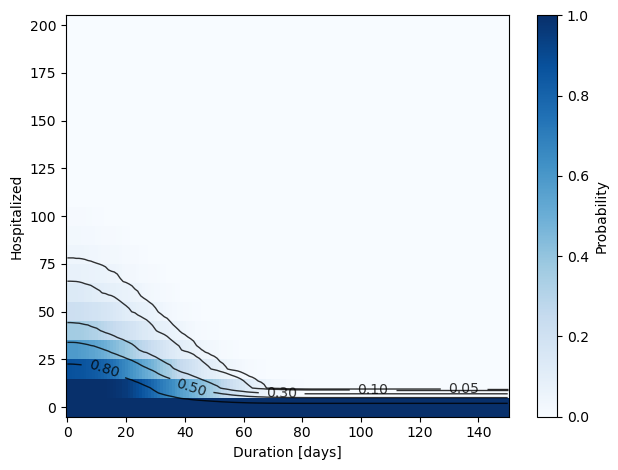

In [7]:
# Define class
LR = LoadRisk(curves=df_curve,verbose = True)

# Get matrix with results
load_and_duration = LR.get_loadandduration()

LR.plot_everything()


# Labels and save result
plt.xlabel('Duration [days]')
plt.ylabel('Hospitalized')
plt.tight_layout()

## Using curvestat to extract curve rankings
As of right now, my best idea is to group curves, then use curvestat data to plot the summaries of each group

In [8]:
# create boxplot instance, add curves
Boxplot = CurveBoxPlot(curves=df_curve,sample_curves=5,sample_repititions=20,time=time_arr)

# rank curves
rank_allornothing=Boxplot.rank_allornothing()

In [9]:
# take rankings, convert to df, sort so most central curves are on top. 
pd.DataFrame(rank_allornothing, index=['points']).T.sort_values('points', ascending=False).reset_index(names='curve_id')

,curve_id,points
0,778,12
1,668,11
2,430,11
3,907,11
4,146,11
...,...,...
995,742,0
996,743,0
997,185,0
998,747,0


In [10]:
# given a ranking dictionary, gets the central x% of curves for each x in list
boundaries = Boxplot.get_boundaries(rank_allornothing,percentiles=[50,90])
len(boundaries['curve-based'][50]['curves'])

575

In [11]:
# curves not in middle 50%
list(set(df_curve.columns) - set(boundaries['curve-based'][50]['curves']));

In [12]:
df_mid_curves = df_curve[boundaries['curve-based'][50]['curves']]
df_outside_curves = df_curve[list(set(df_curve.columns) - set(boundaries['curve-based'][50]['curves']))]
import plotly.graph_objects as go

# Create a figure
fig = go.Figure()

# Add traces for df_mid_curves
for column in df_mid_curves.columns:
    fig.add_trace(go.Scatter(
        x=df_mid_curves.index,
        y=df_mid_curves[column],
        mode='lines',
        name=f'Mid Curves - {column}',
        line=dict(color='rgba(0, 0, 255, 0.2)')  
    ))

# Add traces for df_curve
for column in df_outside_curves.columns:
    fig.add_trace(go.Scatter(
        x=df_curve.index,
        y=df_curve[column],
        mode='lines',
        name=f'Curve - {column}',
        line=dict(color='rgba(255, 0, 0, 0.2)') 
    ))

# Update layout
fig.update_layout(
    title='Middle 50% of Curves (Blue) vs Outer 50% of Curves (Red)',
    xaxis_title='Day',
    yaxis_title='Cases',
    showlegend=False
)

# Show the figure
fig.show()

In [13]:
curves_above_max = 0
for curve in df_outside_curves:
    if boundaries['curve-based'][50]['max-boundary'][df_outside_curves[curve].idxmax()] \
    <  df_outside_curves[curve].max():
        curves_above_max += 1
curves_above_max

195

This is the flaw in curvestat. They rank the curves in a neat way, well done you, but then they immediately go back to the fixed-time statistics and it immediately messes up their graphs. 27 out of 49 curves not in the middle 50% have a peak above the middle 50% max. 

In [14]:
fig = go.Figure()

fig.add_trace(go.Scatter(
        x=list(range(150)),
        y=boundaries['curve-based'][50]['max-boundary'],
        mode='lines',
        name=f'Curve-based 75th Percentile',
        line=dict(color='rgba(0, 255, 0, 1)')  
    ))

fig.add_trace(go.Scatter(
        x=list(range(150)),
        y=boundaries['curve-based'][50]['min-boundary'],
        mode='lines',
        name=f'Curve-based 25th Percentile',
        line=dict(color='rgba(0, 255, 0, 1)')  
    ))

fig.add_trace(go.Scatter(
        x=list(range(150)),
        y=boundaries['fixed-time'][50]['max-boundary'],
        mode='lines',
        name=f'Fixed-time 75th Percentile',
        line=dict(color='rgba(0, 0, 255, 1)')  
    ))

fig.add_trace(go.Scatter(
        x=list(range(150)),
        y=boundaries['fixed-time'][50]['min-boundary'],
        mode='lines',
        name=f'Fixed-time 25th Percentile',
        line=dict(color='rgba(0, 0, 255, 1)')  
    ))

## Considering alternative methods and runtime

In [15]:
df_curve.head()

,0,1,2,3,4,5,6,7,8,9,...,990,991,992,993,994,995,996,997,998,999
0,0.000394,0.000855,0.001109,0.000677,0.000479,0.000408,0.000375,0.000525,0.000466,0.000893,...,0.000550,0.000331,0.000678,0.000691,0.001059,0.000507,0.000377,0.000507,0.000396,0.000410
1,0.000572,0.001478,0.001774,0.001064,0.000699,0.000591,0.000585,0.000892,0.000675,0.001432,...,0.000877,0.000431,0.000991,0.000926,0.001620,0.000668,0.000526,0.000676,0.000623,0.000695
2,0.000824,0.002517,0.002807,0.001656,0.001013,0.000851,0.000904,0.001496,0.000973,0.002272,...,0.001386,0.000559,0.001437,0.001237,0.002457,0.000877,0.000732,0.000898,0.000970,0.001163
3,0.001180,0.004222,0.004395,0.002552,0.001459,0.001218,0.001384,0.002473,0.001393,0.003566,...,0.002166,0.000724,0.002072,0.001647,0.003696,0.001149,0.001012,0.001188,0.001497,0.001920
4,0.001679,0.006978,0.006808,0.003896,0.002086,0.001732,0.002099,0.004033,0.001982,0.005539,...,0.003349,0.000934,0.002968,0.002184,0.005511,0.001499,0.001392,0.001566,0.002287,0.003126


In [16]:
# get the quartile values from the dataframe (I love pandas, what a great library)
medians = df_curve.T.quantile(q=[0,.05, .1, .25, .5, .75, .9, .95, 1], interpolation='higher')

In [17]:
medians.T.head()

,0.00,0.05,0.10,0.25,0.50,0.75,0.90,0.95,1.00
0,0.000299,0.000318,0.000332,0.000385,0.000489,0.000717,0.000986,0.001114,0.001500
1,0.000392,0.000431,0.000463,0.000547,0.000710,0.001042,0.001455,0.001654,0.002522
2,0.000512,0.000576,0.000636,0.000771,0.001034,0.001516,0.002131,0.002543,0.004247
3,0.000666,0.000762,0.000865,0.001051,0.001475,0.002185,0.003152,0.004080,0.007050
4,0.000860,0.001002,0.001152,0.001444,0.002042,0.003221,0.004802,0.006364,0.011540


In [18]:
fig = go.Figure([
    # plot minimum of each time step
    go.Scatter(
        name='Minimum',
        x=medians.T.index,
        y=medians.T[0],
        marker=dict(color="#444"),
        line=dict(width=0),
        mode='lines',
        showlegend=False
    ),
    
    # plot lower quantile of each time step
    go.Scatter(
        name='Lower Quantile',
        x=medians.T.index,
        y=medians.T[0.25],
        marker=dict(color="#444"),
        line=dict(width=0),
        fillcolor='rgba(190, 200, 240, 0.5)',
        fill='tonexty', # this will make the fill go to the previous trace. order matters. 
        showlegend=False
    ),

    # plot upper quantile of each time step
    go.Scatter(
        name='Upper Quantile',
        x=medians.T.index,
        y=medians.T[0.75],
        mode='lines',
        marker=dict(color="#444"),
        line=dict(width=0),
        fillcolor='rgba(190, 200, 240, 0.75)',
        fill='tonexty',
        showlegend=False
    ),
    
    # plot the maximum of each time step
    go.Scatter(
        name='Maximum',
        x=medians.T.index,
        y=medians.T[1],
        mode='lines',
        marker=dict(color="#444"),
        line=dict(width=0),
        fillcolor='rgba(190, 200, 240, 0.5)',
        fill='tonexty',
        showlegend=False
    ),
    
    # plot median
    go.Scatter(
        name='Median',
        x=medians.T.index,
        y=medians.T[0.5],
        marker=dict(color="black"),
        line=dict(width=1),
        mode='lines',
        showlegend=False
    )
])

fig.update_layout(
    yaxis_title='Cases', xaxis_title='Day',
    title='Curve Quantile Plot',
    hovermode="x"
)
fig.show()

## What if we plot every single percentile over every single time step?

In [19]:
# getting peak kde from curvestat
heatmapcurves_all = list(boundaries['curve-based'][90]['curves'])
heatmap_90 = Boxplot.get_peakheatmap(heatmap_curves=heatmapcurves_all)

# fig_heatmap = px.scatter(heatmap, x='peak_time', y='peak_value', color='peak_density', )
fig_heatmap = go.Scatter(x=heatmap_90['peak_time'], y=heatmap_90['peak_value'], mode='markers',
                        marker=dict(color=heatmap_90['peak_density']
                                   
                        ))
go.Figure(fig_heatmap)

In [20]:
# this runs an order of magnitude faster
start = time()

# check every percentile
quantiles = np.linspace(0, 100, 101)/100

# get quantiles
medians = df_curve.T.quantile(q=quantiles, interpolation='higher')

# instantiate a list to hold our traces
trace_list = []

for i in medians.index[:-round(len(medians.index)/2)]:
    
    # upper percentile trace
    trace_list.append(go.Scatter(
            name=f'Percentile {round(1-i, 2) * 100}',
            x=medians.columns,
            y=medians.T[round(1-i, 2)],
            marker=dict(color="#444"),
            line=dict(width=0),
            mode='lines',
            showlegend=False
        ))

    # lower percentile trace
    trace_list.append(go.Scatter(
        name=f'Percentile {i*100}',
        x=medians.columns,
        y=medians.T[i],
        marker=dict(color="#444"),
        line=dict(width=0),
        fillcolor='rgba(256, 30, 40, 0.03)',
        fill='tonexty', # fill to previous trace
        showlegend=False
        ))

# trace_list.append(fig_heatmap)
    
# feed traces to plotly
fig = go.Figure(trace_list)

fig.update_layout(
    yaxis_title='Cases', xaxis_title='Day',
    title='Curve Quantile Plot',
#     hovermode="x"
)

fig.show()
end = time()
diff = end-start
print(f"Ran {num_curves} curves in {round(diff, 2)} seconds")

Ran 1000 curves in 0.19 seconds


The problem that we have isn't that the median undersells the maximum, or that the spaghetti plots are hard to understand. The issue is statistical illiteracy. Some who reads any of these plots with an idea of how probability works is not going to assume that the median is the God Line, all hail the median. The data generated here suggests that the majority of scenarios feature a peak case/day number of 40. We shouldn't be worried that our median line is below 40. We should be worried that people look at the median line and <i>don't know what it means.</i>

In [21]:
maxes = {'x':[], 'y':[]}
for c in df_curve:
    maxes['x'].append(df_curve[c].idxmax())
    maxes['y'].append(df_curve[c].max())
df_maxes = pd.DataFrame(maxes)

# Grouping Curves
One time comparisons
- 2d by peak (note that peak is two dimensional)
- 3d by peak, standard deviation
- 

In [22]:
from sklearn.cluster import KMeans
from sklearn.metrics.pairwise import euclidean_distances

group curves, then plot summary statistics (fixed time and/or curve-based) for each

## Pairwise comparison of area between curves

In [23]:
start = time()
# unfortunately, pairwise comparisons are O(n^2)
curve_diff = dict()

for first_curve in df_curve.columns:
    for second_curve in df_curve.columns[first_curve+1:]:
        curve_diff[(first_curve, second_curve)] = \
        ((df_curve[first_curve] - df_curve[second_curve])**2).abs().sum()
end = time()
print(f'pairwise compared {num_curves} curves in {round(end-start, 4)} seconds')

pairwise compared 1000 curves in 102.9637 seconds


In [25]:
# Get all unique elements
elements = sorted(set(i for pair in curve_diff.keys() for i in pair))
n = len(elements)

# Create the distance matrix
distance_matrix = np.zeros((n, n))
for (i, j), score in curve_diff.items():
    distance_matrix[i, j] = score
    distance_matrix[j, i] = score  # Because the matrix is symmetric

# Convert distance matrix to similarity matrix
similarity_matrix = np.max(distance_matrix) - distance_matrix

# Fit K-Means clustering
k = 4  # Change this to the number of desired clusters
kmeans = KMeans(n_clusters=k)
labels = kmeans.fit_predict(similarity_matrix)

C:\Users\elija\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

C:\Users\elija\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.



In [26]:
colors = ['black', 'red', 'blue', 'green', 'gray', 'cyan']
cmap = dict(zip(range(len(colors)), colors))

In [27]:
traces = []
# Plot each curve with its respective color based on the group
for column, group in zip(df_curve.columns, labels):
    trace = go.Scatter(
        x=df_curve.index,
        y=df_curve[column],
        mode='lines',
        name=f'Curve {column}',
        line=dict(color=cmap[group])
    )
    traces.append(trace)

fig = go.Figure(traces)
    
# Update layout
fig.update_layout(
    title='Curves Colored by Group',
    xaxis_title='Day',
    yaxis_title='Cases',
    showlegend=False
)

# Show the plot
fig.show()

In [29]:
from matplotlib.colors import to_rgba

In [30]:
# Create a dictionary to hold arrays for each label
label_dict = {}

# Iterate over unique labels
for label in set(labels):
    # Get the indices of the columns that belong to this label
    columns_for_label = [df_curve.columns[i] for i, lbl in enumerate(labels) if lbl == label]
    
    # Slice the DataFrame for the current label
    df_for_label = df_curve[columns_for_label]
    
    # Store the sliced DataFrame in the dictionary
    label_dict[label] = {'data': df_for_label}

In [31]:
label_dict[1]['data']

,10,12,16,17,18,20,27,28,29,31,...,974,976,980,981,983,989,991,993,995,997
0,0.000304,0.000322,0.000458,0.000613,0.000341,0.000367,1.055388e-03,0.000838,0.000389,0.000532,...,0.000331,0.000404,0.000329,0.000327,0.000428,0.000471,0.000331,0.000691,0.000507,0.000507
1,0.000405,0.000424,0.000595,0.000833,0.000463,0.000475,1.499930e-03,0.001168,0.000540,0.000722,...,0.000451,0.000536,0.000435,0.000434,0.000591,0.000611,0.000431,0.000926,0.000668,0.000676
2,0.000538,0.000556,0.000771,0.001127,0.000628,0.000613,2.119742e-03,0.001619,0.000746,0.000977,...,0.000612,0.000708,0.000574,0.000575,0.000814,0.000791,0.000559,0.001237,0.000877,0.000898
3,0.000711,0.000727,0.000996,0.001518,0.000846,0.000789,2.978844e-03,0.002233,0.001025,0.001316,...,0.000826,0.000932,0.000754,0.000758,0.001115,0.001022,0.000724,0.001647,0.001149,0.001188
4,0.000937,0.000947,0.001282,0.002037,0.001137,0.001012,4.162610e-03,0.003064,0.001403,0.001765,...,0.001111,0.001223,0.000988,0.000996,0.001521,0.001315,0.000934,0.002184,0.001499,0.001566
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145,0.009552,0.049973,0.288568,0.001018,0.000478,0.366893,4.092819e-07,0.000018,0.000016,0.000956,...,0.000395,0.022776,0.024518,0.014782,0.000036,0.327170,0.166176,0.008333,0.061934,0.014414
146,0.007493,0.040584,0.241934,0.000751,0.000352,0.310945,2.569585e-07,0.000012,0.000011,0.000706,...,0.000290,0.018092,0.019594,0.011686,0.000025,0.274919,0.138591,0.006406,0.050033,0.011282
147,0.005856,0.032849,0.202223,0.000552,0.000257,0.262760,1.604192e-07,0.000008,0.000008,0.000520,...,0.000211,0.014320,0.015604,0.009205,0.000017,0.230321,0.115231,0.004905,0.040283,0.008799
148,0.004560,0.026500,0.168520,0.000404,0.000188,0.221395,9.958698e-08,0.000006,0.000005,0.000381,...,0.000154,0.011294,0.012383,0.007225,0.000012,0.192379,0.095514,0.003742,0.032323,0.006837


In [32]:
for label in set(labels):
    label_dict[label]['quantiles'] = label_dict[label]['data'].T.quantile(q=[0,.05, .1, .25, .5, .75, .9, .95, 1], interpolation='higher')

In [33]:
traces = []

for label in set(labels):
    # plot median
    tr = [go.Scatter(
            name=f'Median {label}',
            x=label_dict[label]['quantiles'].T.index,
            y=label_dict[label]['quantiles'].T[0.5],
            marker=dict(color=cmap[label]),
            line=dict(width=1),
            mode='lines',
            showlegend=False
        ),
        # plot minimum of each time step
        go.Scatter(
            name=f'Minimum {label}',
            x=label_dict[label]['quantiles'].T.index,
            y=label_dict[label]['quantiles'].T[0],
            marker=dict(color="#444"),
            line=dict(width=0),
            mode='lines',
            showlegend=False
        ),
        # maximum
        go.Scatter(
            name=f'Maximum {label}',
            x=label_dict[label]['quantiles'].T.index,
            y=label_dict[label]['quantiles'].T[1],
            mode='lines',
            marker=dict(color="#444"),
            line=dict(width=0),
            fillcolor='rgba' + str(to_rgba(cmap[label], alpha = .2)),
            fill='tonexty',
            showlegend=False
        ),
         ]
    
    traces += tr
    
go.Figure(traces)

In [34]:

# check every percentile
quantiles = np.linspace(0, 100, 101)/100

# instantiate a list to hold our traces
trace_list = []

for label in set(labels):
    # get quantiles
    quan = label_dict[label]['data'].T.quantile(q=quantiles, interpolation='higher')

    for i in medians.index[:-round(len(medians.index)/2)]:

        # upper percentile trace
        trace_list.append(go.Scatter(
                name=f'Percentile {round(1-i, 2) * 100} Group {label}',
                x=quan.columns,
                y=quan.T[round(1-i, 2)],
                marker=dict(color="#444"),
                line=dict(width=0),
                mode='lines',
                showlegend=False
            ))

        # lower percentile trace
        trace_list.append(go.Scatter(
            name=f'Percentile {i*100} Group {label}',
            x=quan.columns,
            y=quan.T[i],
            marker=dict(color="#444"),
            line=dict(width=0),
            fillcolor='rgba' + str(to_rgba(cmap[label], alpha = .02)),
            fill='tonexty', # fill to previous trace
            showlegend=False
            ))

# trace_list.append(fig_heatmap)
    
# feed traces to plotly
fig = go.Figure(trace_list)

fig.update_layout(
    yaxis_title='Cases', xaxis_title='Day',
    title='Curve Quantile Plot',
#     hovermode="x"
)

fig.show()

## Using summary statistics for each curve: standard deviation and peak

In [35]:
# get and store peak (day and value) and curve standard deviation
start = time()
df_curve_stats = pd.DataFrame()
df_curve_stats['std'] = df_curve.std()
df_curve_stats['max'] = df_curve.max()
df_curve_stats['day_max'] = df_curve.idxmax()
end=time()
print(f'assembled stats on {num_curves} in {end-start} seconds')

assembled stats on 1000 in 0.004156589508056641 seconds


In [36]:
df_curve_stats.head()

,std,max,day_max
0,8.117527,25.052896,59
1,7.352563,26.210638,37
2,14.088652,47.195920,45
3,9.372839,30.951224,47
4,9.583712,29.724566,58


In [37]:
X = df_curve_stats.values

# Perform k-means clustering
kmeans = KMeans(n_clusters=3, random_state=42)
summary_labels = kmeans.fit_predict(X)

C:\Users\elija\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

C:\Users\elija\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.



In [38]:
# Create a dictionary to hold arrays for each label
summary_label_dict = {}

# Iterate over unique labels
for label in set(summary_labels):
    # Get the indices of the columns that belong to this label
    columns_for_label = [df_curve.columns[i] for i, lbl in enumerate(summary_labels) if lbl == label]
    
    # Slice the DataFrame for the current label
    df_for_label = df_curve[columns_for_label]
    
    # Store the sliced DataFrame in the dictionary
    summary_label_dict[label] = {'data': df_for_label}
    
for label in set(summary_labels):
    summary_label_dict[label]['quantiles'] = summary_label_dict[label]['data'].T.quantile(q=[0,.05, .1, .25, .5, .75, .9, .95, 1], interpolation='higher')

In [39]:
traces = []
# Plot each curve with its respective color based on the group
for column, group in zip(df_curve.columns, summary_labels):
    trace = go.Scatter(
        x=df_curve.index,
        y=df_curve[column],
        mode='lines',
        name=f'Curve {column}',
        line=dict(color=cmap[group])
    )
    traces.append(trace)

fig = go.Figure(traces)
    
# Update layout
fig.update_layout(
    title='Curves Colored by Group',
    xaxis_title='Day',
    yaxis_title='Cases',
    showlegend=False
)

# Show the plot
fig.show()

In [40]:
cmap

{0: 'black', 1: 'red', 2: 'blue', 3: 'green', 4: 'gray', 5: 'cyan'}

In [41]:
traces = []

for label in set(summary_labels):
    # plot median
    tr = [go.Scatter(
            name=f'Median {label}',
            x=summary_label_dict[label]['quantiles'].T.index,
            y=summary_label_dict[label]['quantiles'].T[0.5],
            marker=dict(color=cmap[label]),
            line=dict(width=1),
            mode='lines',
            showlegend=False
        ),
        # plot minimum of each time step
        go.Scatter(
            name=f'Minimum {label}',
            x=summary_label_dict[label]['quantiles'].T.index,
            y=summary_label_dict[label]['quantiles'].T[0],
            marker=dict(color="#444"),
            line=dict(width=0),
            mode='lines',
            showlegend=False
        ),
        # maximum
        go.Scatter(
            name=f'Maximum {label}',
            x=summary_label_dict[label]['quantiles'].T.index,
            y=summary_label_dict[label]['quantiles'].T[1],
            mode='lines',
            marker=dict(color="#444"),
            line=dict(width=0),
            fillcolor='rgba' + str(to_rgba(cmap[label], alpha = .2)),
            fill='tonexty',
            showlegend=False
        ),
         ]
    
    traces += tr
    
go.Figure(traces)

# Combining curvestat and grouping
1. Create groups
2. Run Boxplot, rank_allornothing, get_boundaries on each group
3. Throw it all in plotly and see what happens

Could iterate through and do this for all percentiles to create a graph similar to heatmap-thingy I like. 

In [46]:
# labels generated via pairwise area comparisons
labels;

In [43]:
di = defaultdict(lambda: defaultdict())
for label in np.unique(labels):
    di[label]['data'] = df_curve[[i for i in df_curve.columns if labels[i] == label]]
    
    # create boxplot instance, add curves
    Boxplot = CurveBoxPlot(curves=di[label]['data'],sample_curves=5,sample_repititions=20,time=time_arr)

    # rank curves
    rank_allornothing=Boxplot.rank_allornothing()
    boundaries = Boxplot.get_boundaries(rank_allornothing,percentiles=[1, 50,90])
    
    di[label]['boundaries'] = boundaries

In [47]:
# example usage: for group 2, get the curves that make up the middle 90% in curve-based ranking
di[2]['boundaries']['curve-based'][90]['curves'];

In [49]:
fig = go.Figure()

for group in di:

        fig.add_trace(go.Scatter(
            name=f'Lower Quartile {group}',
            x=time_arr,
            y=di[group]['boundaries']['curve-based'][50]['min-boundary'],
            marker=dict(color="#444"),
            line=dict(width=0),
            mode='lines',
            showlegend=False))
        
        fig.add_trace(go.Scatter(
            name=f'Upper Quartile {group}',
            x=time_arr,
            y=di[group]['boundaries']['curve-based'][50]['max-boundary'],
            mode='lines',
            marker=dict(color="#444"),
            line=dict(width=0),
            fillcolor='rgba' + str(to_rgba(cmap[group], alpha = .1)),
            fill='tonexty',
            showlegend=False
        ))
        
        fig.add_trace(go.Scatter(
            name=f'Median {group}',
            x=time_arr,
            y=df_curve[di[group]['boundaries']['curve-based'][1]['curves'][0]],
            marker=dict(color=cmap[group]),
            line=dict(width=1),
            mode='lines',
            showlegend=False
        ))

fig.update_layout(
    title='Middle 90% Curves of For Each Group',
    xaxis_title='Day',
    yaxis_title='Cases',
    showlegend=False
)        
fig.show()